<center> <font size="15">DEMO AVISO</font>

# Introduction to AVISO-data

The following demo illustrates how to extract elliptic and hyperbolic Lagrangian Coherent structures from the [AVISO data set](http://aviso.oceanobs.com) (a 2D satellite-altimetry-derived ocean surface current product). The data is freely available from the [Copernicus Marine Environment](https://marine.copernicus.eu).

The sea surface height $ h $ acts as a stream function for the geostrophic ocean surface velocity field. Particle trajectories on the ocean surface are approximately trajectories of the 2D system of ODEs:

\begin{align}
\dot{\varphi} &= -\dfrac{g}{R^2f(\theta)cos(\theta)}\partial_{\theta}h(\phi, \theta, t) \\
\dot{\theta} &= \dfrac{g}{R^2f(\theta)cos(\theta)}\partial_{\varphi}h(\phi, \theta, t),
\end{align}

where $ \varphi, \theta $ respectively are the longitudinal and latitudinal position of the particle, $ g $ is the constant of gravity, $ R $ is the mean radius, $ f(\theta) = 2\Omega \sin(\theta) $ is the coriolis parameter and $ \Omega $ is the mean angular velocity of the earth.

The AVISO-data provides global coverage of ocean currents at daily time-intervals with a spatial resolution of $ 0.25^{\circ} $. As part of this work, we focus on two commonly studied oceanographic regions:

1. Agulhas leakage in the Southern Ocean:
\begin{equation}
(\varphi, \theta) \in [14^{\circ}W, 9^{\circ}E] \times [39^{\circ}S, 21^{\circ}S]
\end{equation} 
over a period of $ t_N - t_0 $ where $ t_0 = 24 $ Novembre 2006.
2. Gulf of Mexico:
\begin{equation}
(\varphi, \theta) \in [100^{\circ}W, 80^{\circ}W] \times [20^{\circ}N, 30^{\circ}N]
\end{equation} 
over a period of $ t_N - t_0 $ where $ t_0 = 20 $ January 2016.

The length of the period $ t_N-t_0 $ depends on the specific application and method we will be considering.

## Import AVISO data

In [1]:
from netCDF4 import Dataset, num2date
from datetime import datetime
import numpy as np

def Import_AVISO(file):
    
    fileobj = Dataset(file, 'r')

    xlon = fileobj.variables['longitude'][:]
    ylat = fileobj.variables['latitude'][:]
    u = fileobj.variables['ugos'][:,:,:].transpose((1, 2, 0))
    v = fileobj.variables['vgos'][:,:,:].transpose((1, 2, 0))
    nctime = fileobj.variables['time'][:]
    t_unit = fileobj.variables['time'].units  # get unit  "days since 1950-01-01T00:00:00Z"

    t_cal = fileobj.variables['time'].calendar

    date_gregorian = [num2date(nctime[i], units=t_unit, calendar=t_cal) for i in range(len(nctime))]
    time = (np.array(nctime)) - nctime[0]
            
    return xlon, ylat, u, v, date_gregorian, time

#Import velocity data from file in data-folder
x, y, u, v, date_gregorian, time = Import_AVISO('./data/Files/AVISO_Agulhas.nc')
X, Y = np.meshgrid(x, y)

/opt/anaconda3/envs/TBarrier/lib/python3.7/site-packages/ipykernel_launcher.py:14: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  
/opt/anaconda3/envs/TBarrier/lib/python3.7/site-packages/ipykernel_launcher.py:16: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  app.launch_new_instance()


## Convert velocity units from $ \dfrac{m}{s} $ to $ \dfrac{deg}{d} $ 

In [2]:
earthRadius = 6371*(10**3)
        
U, V = np.zeros(u.shape), np.zeros(v.shape)
    
for i in range(U.shape[0]):
    
    for j in range(V.shape[1]):
    
        for k in range(V.shape[2]):
            
            U[i, j, k] = (u[i, j, k] / (np.cos(y[i]*(np.pi/180))*(earthRadius)))*180*3600*24/np.pi
            V[i, j, k] = (v[i, j, k] / earthRadius)*180*3600*24/np.pi

In [3]:
%%time
# Import and initialize class Dynamical system
import sys
sys.path.append("./classes")
from ipynb.fs.defs.Dynamical_System import *
DS = Dynamical_System()

CPU times: user 55.8 ms, sys: 9.73 ms, total: 65.5 ms
Wall time: 64.7 ms


In [4]:
# Number of cores to be used for parallel computing
Ncores = 16

# Incompressible/Compressible flow. {True, False}
incompressible = True

# Periodic boundary conditions
periodic_boundary_x = False
periodic_boundary_y = False
periodic_boundary = [periodic_boundary_x, periodic_boundary_y]

# List of parameters of the flow.
params_data = X, Y, time, U, V, Ncores, incompressible, periodic_boundary

# Initialize data
DS._init_data(params_data)

In [5]:
%%time
# Initial time (in days)
t0 = 0

# Final time (in days)
tN = 20

# time step-size
dt = .1

time = np.arange(t0, tN+dt, dt)

# longitudinal and latitudinal boundaries (in degrees)
xmin = -5
xmax = 0
ymin = -35
ymax = -30

# spacing of meshgrid (in degrees)
dx = 0.2
dy = 0.2

x_grid = np.arange(xmin, xmax + dx, dx)
y_grid = np.arange(ymin, ymax + dy, dy)

params_ds = time, x_grid, y_grid
DS._init_ds(params_ds)

CPU times: user 367 µs, sys: 140 µs, total: 507 µs
Wall time: 447 µs


In [6]:
%%time
DS._Interpolation_velocity("linear")

CPU times: user 269 ms, sys: 29.8 ms, total: 298 ms
Wall time: 298 ms


In [7]:
DS._trajectory_grid();

  0%|          | 0/26 [00:00<?, ?it/s]

[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done  22 out of  26 | elapsed:   11.5s remaining:    2.1s
[Parallel(n_jobs=16)]: Done  26 out of  26 | elapsed:   11.9s finished


In [8]:
DS._grad_Fmap_grid(aux_grid = False);

In [9]:
DS._cauchy_green_strain();

In [10]:
FTLE = DS._FTLE_()

=================FTLE=================


In [11]:
%matplotlib notebook
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**128
from IPython.display import HTML

c = FTLE[1].ravel()
x = DS.trajectory_grid[:,:,0,0].ravel()
y = DS.trajectory_grid[:,:,1,0].ravel()

steps = np.arange(0, DS.lenT, 1)

plt.ioff()
# create figure and axes
fig, ax = plt.subplots(1, figsize=(8, 4))
scat = ax.scatter(x, y, c=c, s=6, cmap = r'gist_rainbow_r')
ax.set_xlabel(r'$\varphi$')
ax.set_ylabel(r'$\theta$')
fig.colorbar(scat)

def update_plot(i, X, Y, scat):
    x_data = X[:,:,i].ravel()
    y_data = Y[:,:,i].ravel()
    ax.set_title(f'$FTLE_{{{int(DS.t0)}d}}^{{{int(DS.tN)}d}}(t = {{{np.around(DS.time[i], 2)}d}})$')
    ax.set_xlim(np.nanmin(x_data), np.nanmax(x_data))
    ax.set_ylim(np.nanmin(y_data), np.nanmax(y_data))
    scat.set_offsets(np.column_stack([x_data, y_data]))
    return scat,
    
# the FuncAnimation function iterates through our animate function using the steps array
ani = animation.FuncAnimation(fig, update_plot, frames=steps,
                                  fargs=(DS.trajectory_grid[:,:,0,:], DS.trajectory_grid[:,:,1,:], scat), 
                                  interval = 50, 
                                  blit = True)
plt.close(fig)
plt.ion()

HTML(ani.to_jshtml())

In [12]:
DS._hyperbolic_LCS_local_variational_theory()

=================Hyperbolic LCS from local variational theory=================


In [13]:
loc_max_x, loc_max_y, loc_max_field = DS._find_2D_peaks(1, DS.X_domain, DS.Y_domain, FTLE[1])

<IPython.core.display.Javascript object>


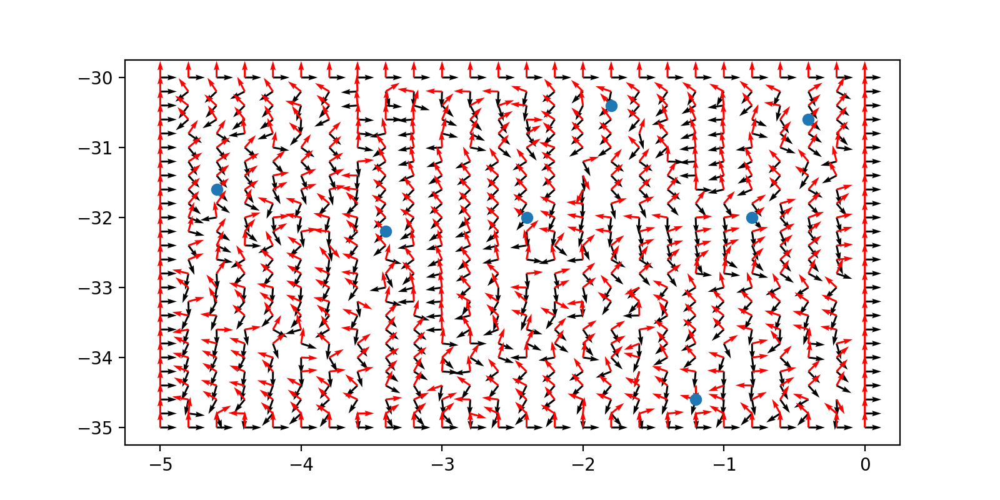

In [14]:
fig = plt.figure(figsize=(8, 4))
ax = plt.axes()
ax.quiver(DS.X_domain, DS.Y_domain, DS.e2[:,:,0], DS.e2[:,:,1], color= "k")
ax.quiver(DS.X_domain, DS.Y_domain, DS.e1[:,:,0], DS.e1[:,:,1], color= "r")
ax.scatter(loc_max_x, loc_max_y)
plt.show()